# 3. Exploratory Data Analysis 

## 3.1 Read data

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
df = pd.read_csv('train2.csv')

In [3]:
df.head()

,Unnamed: 0,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,...,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,0,1,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,...,0,0,0,0,0,2,2008,WD,Normal,208500
1,1,2,20,RL,80.0,9600,Pave,Reg,Lvl,AllPub,...,0,0,0,0,0,5,2007,WD,Normal,181500
2,2,3,60,RL,68.0,11250,Pave,IR1,Lvl,AllPub,...,0,0,0,0,0,9,2008,WD,Normal,223500
3,3,4,70,RL,60.0,9550,Pave,IR1,Lvl,AllPub,...,272,0,0,0,0,2,2006,WD,Abnorml,140000
4,4,5,60,RL,84.0,14260,Pave,IR1,Lvl,AllPub,...,0,0,0,0,0,12,2008,WD,Normal,250000


In [4]:
df.groupby('SaleCondition')['LotFrontage','YrSold'].mean()

,LotFrontage,YrSold
SaleCondition,,
Abnorml,56.495050,2007.663366
AdjLand,54.500000,2006.750000
Alloca,54.000000,2008.166667
Family,66.000000,2007.200000
Normal,55.449917,2007.897329
Partial,78.472000,2007.256000


## 3.2 Correlation Matrix

### 3.2.1 Correlation Matrix with heatmap

<AxesSubplot:>

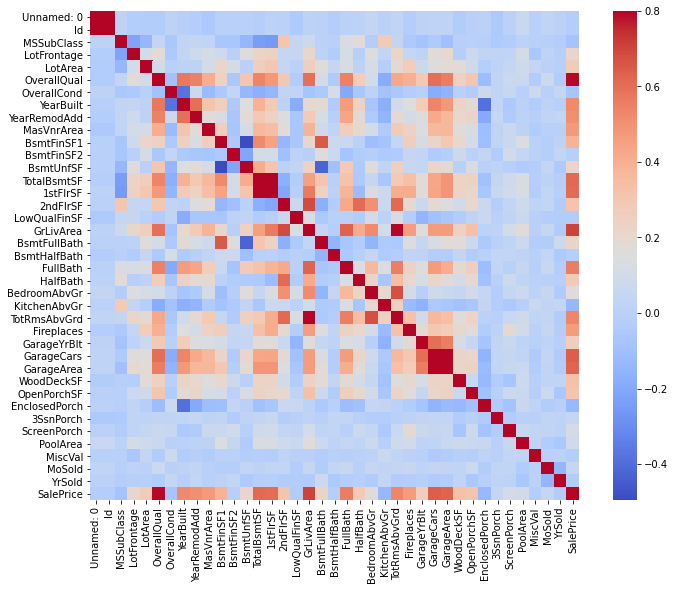

In [5]:
# Correlation matrix
corrmat = df.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True,cmap="coolwarm")

From above matrix we can see that features like OverallQual, GrLivArea, GarageArea, GarageCars,YearBuilt etc have strong correlation with SalesPrice.

### 3.2.2 Top correlations with sales price

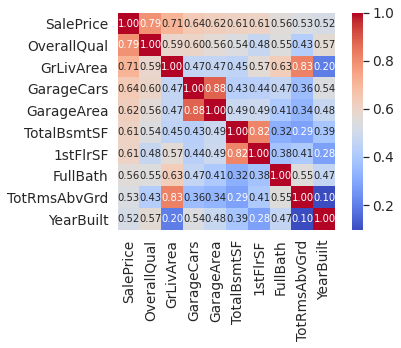

In [6]:
# Top feature correlation with SalesPrice 
k = 10 #number of variables for heatmap
cols = corrmat.nlargest(k, 'SalePrice')['SalePrice'].index
cm = np.corrcoef(df[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values, cmap="coolwarm")
plt.show()

## 3.3 Pair Plots

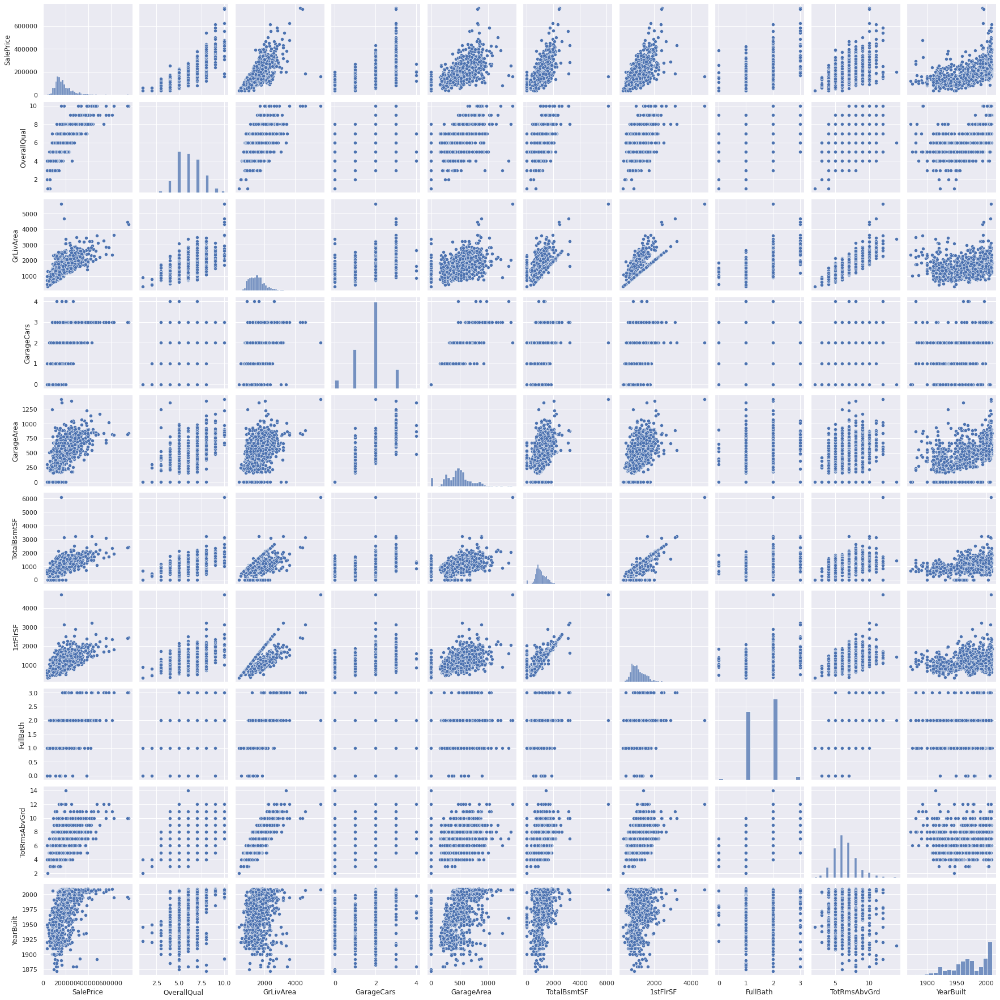

In [7]:
#scatterplot
sns.set()
# cols = ['SalePrice', 'OverallQual', 'GrLivArea', 'GarageArea','GarageCars', 'TotalBsmtSF', 'FullBath', 'YearBuilt']
sns.pairplot(df[cols], height = 2.5)
plt.show();

## 3.4 Scatter Plots

In [8]:
# functuion to plot scatter plot
def scatterPlot(feature):
    plt.scatter(df[feature], df['SalePrice'], alpha=0.5)
    plt.xlabel(feature)
    plt.ylabel("Sale Price")
    plt.show()

### 3.4.1 Ground living area

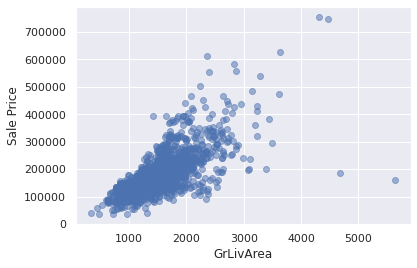

In [9]:
scatterPlot('GrLivArea')

### 3.4.2 Garage Area

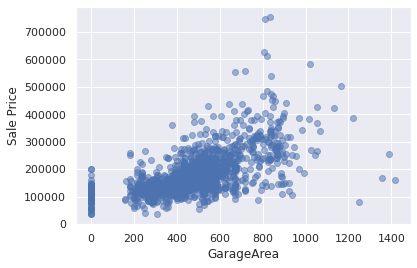

In [10]:
scatterPlot('GarageArea')

### 3.4.3 First Floor square feet

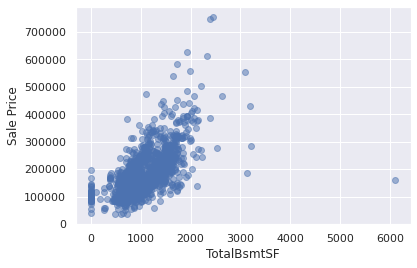

In [11]:
scatterPlot('TotalBsmtSF') 

### 3.4.5 Year built

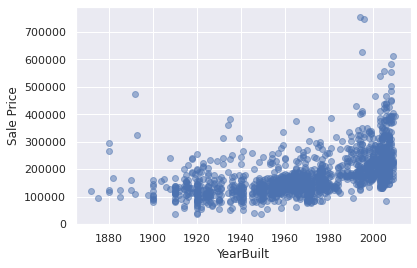

In [12]:
scatterPlot('YearBuilt')

From above plots we can see each of these features have a somewhat linear relationship with Sales Price.

## 3.5 Features analysis

In [13]:
nominal = [ 'MSZoning' ,'Street' ,'LotShape' ,'Utilities' ,'LotConfig' ,'Neighborhood' ,'RoofStyle' ,'RoofMatl' ,'Exterior1st' ,'Exterior2nd' ,'MasVnrType' ,'Foundation' ,'Heating' ,'CentralAir' ,'Electrical' ,'GarageType'  ,'SaleType' ,'SaleCondition']

ordinal = ['LandContour', 'LandSlope' ,'Condition1' ,'Condition2' ,'BldgType' ,'HouseStyle' ,'OverallQual' ,'OverallCond' ,'ExterQual' ,'ExterCond' ,'BsmtQual' ,'BsmtCond' ,'BsmtExposure' ,'BsmtFinType1' ,'HeatingQC' ,'GarageFinish' ,'GarageCars' ,'GarageQual' ,'GarageCond' , 'BsmtFinType2', 'KitchenQual','Functional','PavedDrive']

continous = ['MSSubClass','YearBuilt' , 'YearRemodAdd' , 'MasVnrArea' , '1stFlrSF' , '2ndFlrSF' , 'LowQualFinSF' , 'GrLivArea' , 'FullBath' , 'HalfBath' , 'BedroomAbvGr' , 'KitchenAbvGr' , 'Fireplaces' , 'GarageYrBlt' , 'GarageArea' , 'WoodDeckSF' , 'OpenPorchSF' , 'EnclosedPorch' , '3SsnPorch' , 'ScreenPorch' , 'PoolArea' , 'MoSold' , 'YrSold','LotFrontage', 'LotArea', 'BsmtFinSF1','BsmtFinSF2','BsmtUnfSF', 'BsmtFullBath','TotalBsmtSF','BsmtHalfBath','TotRmsAbvGrd','MiscVal']

### 3.5.1 Nominal Features

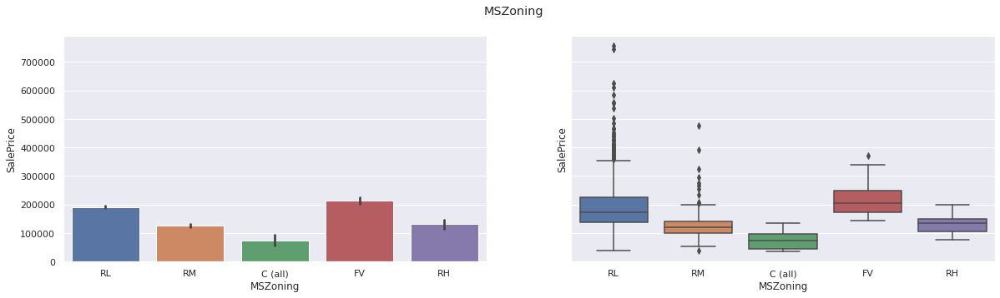

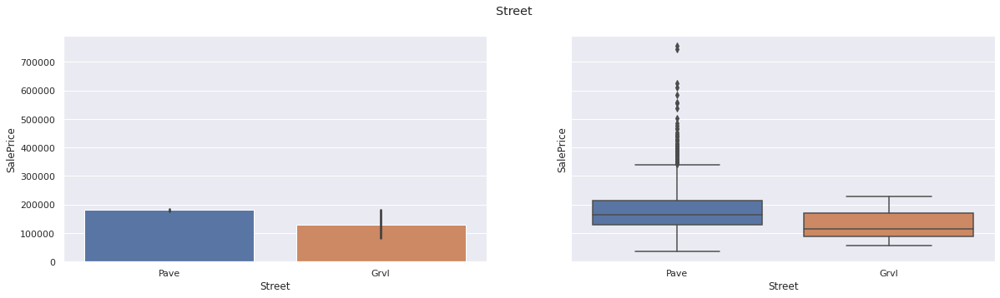

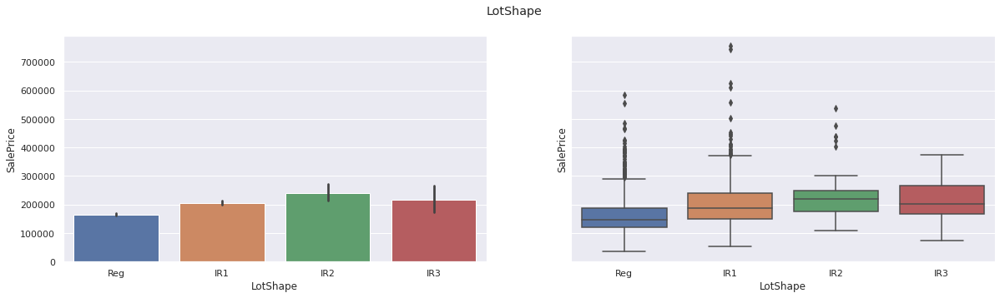

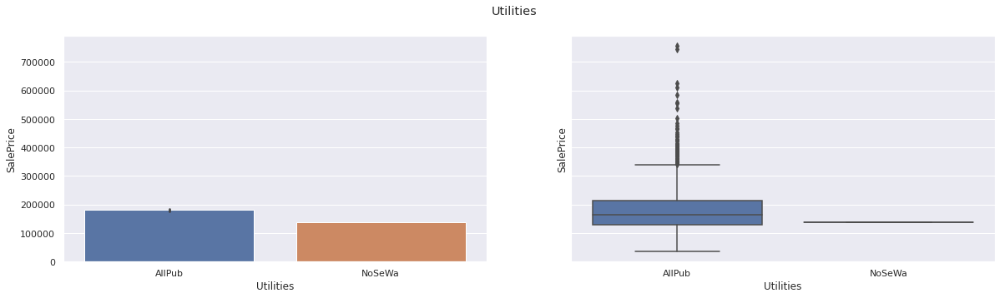

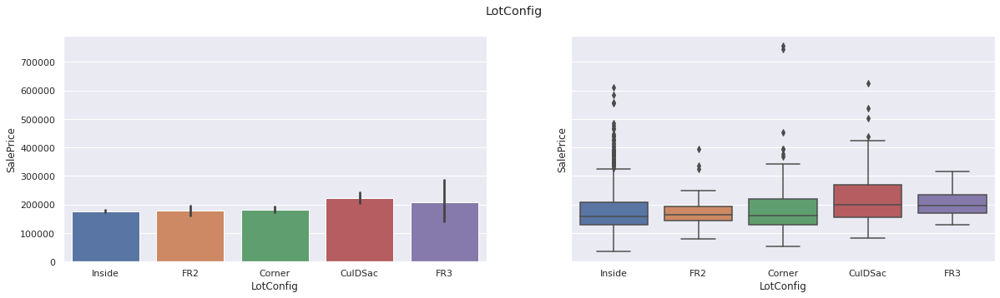

...

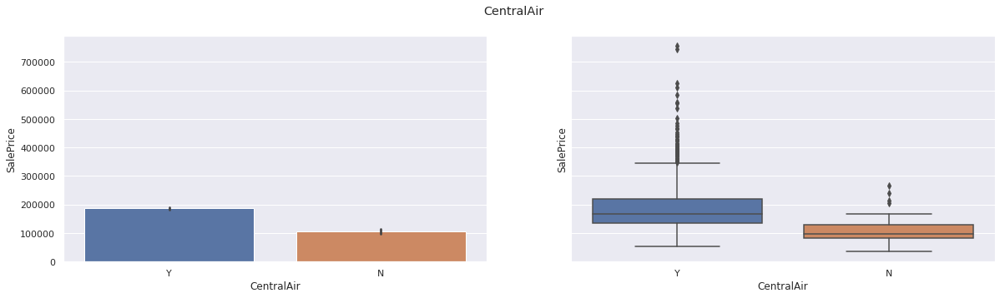

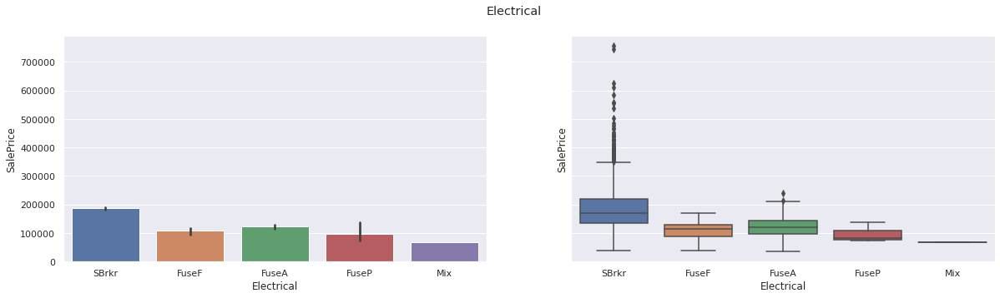

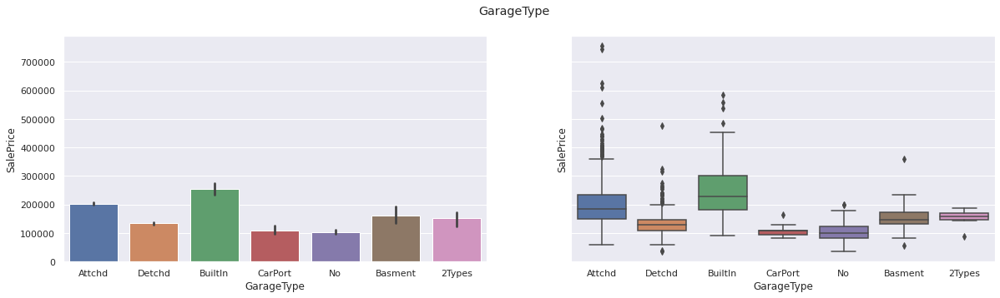

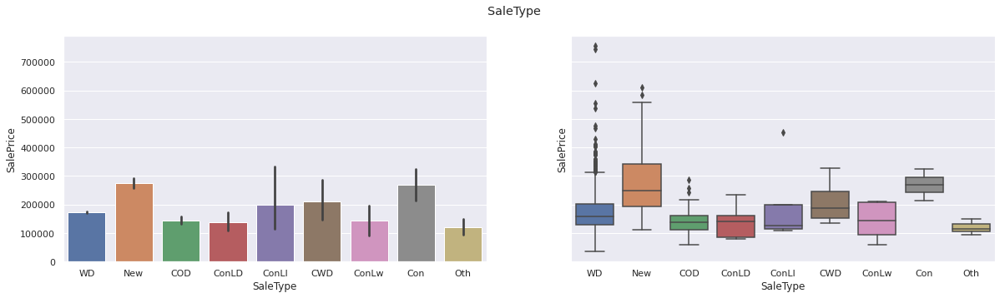

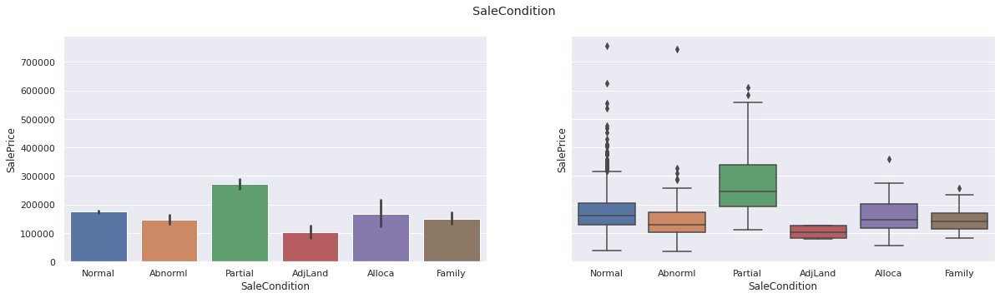

In [14]:
for feature in nominal:
    fig, ax =plt.subplots(1,2,figsize=(20, 5), sharey=True)
    sns.barplot(data = df, x=feature, y='SalePrice',ax=ax[0])
    sns.boxplot(data=df, x=feature, y="SalePrice", ax=ax[1])
    fig.suptitle(feature)
    fig.show()

### 3.5.2 Ordinal Features

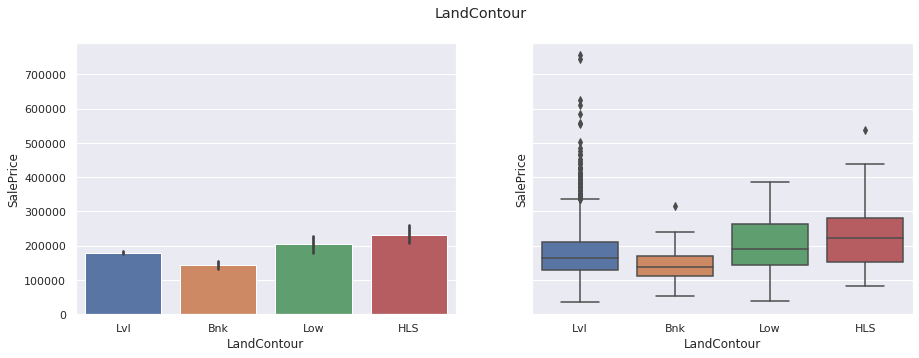

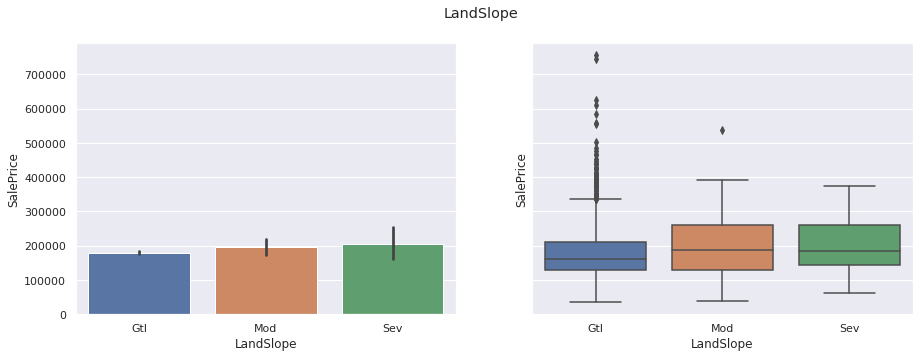

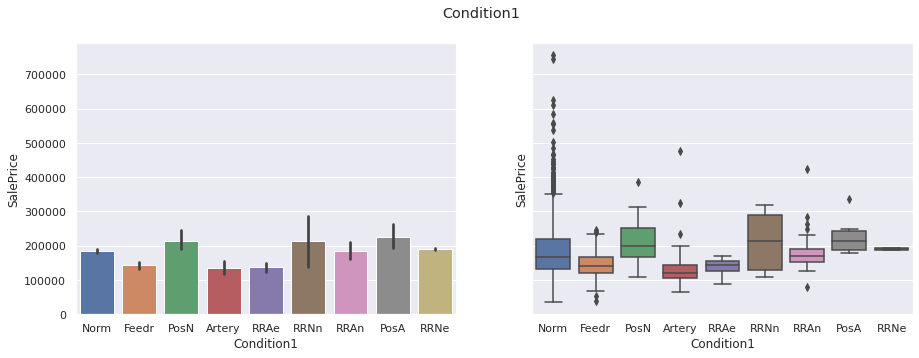

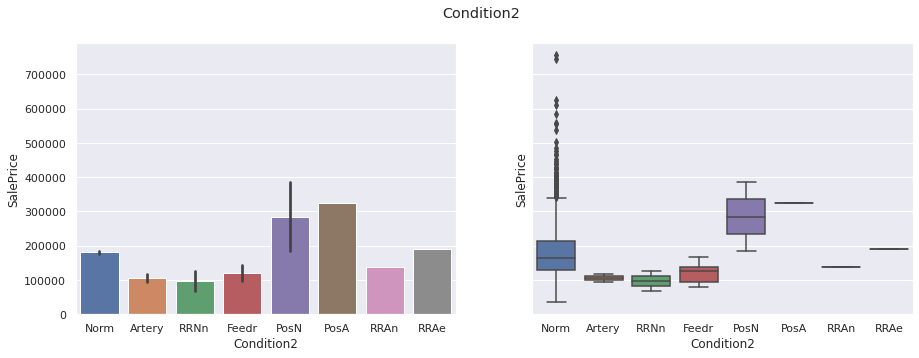

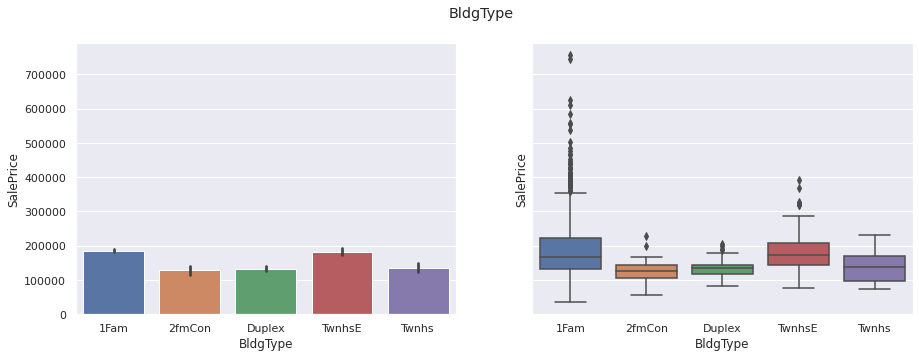

...

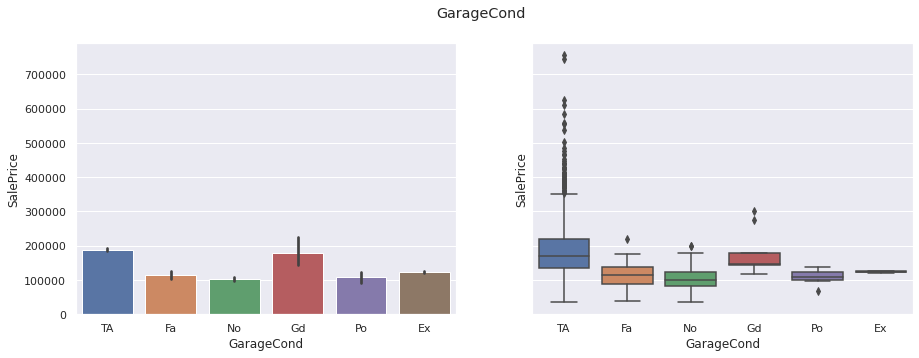

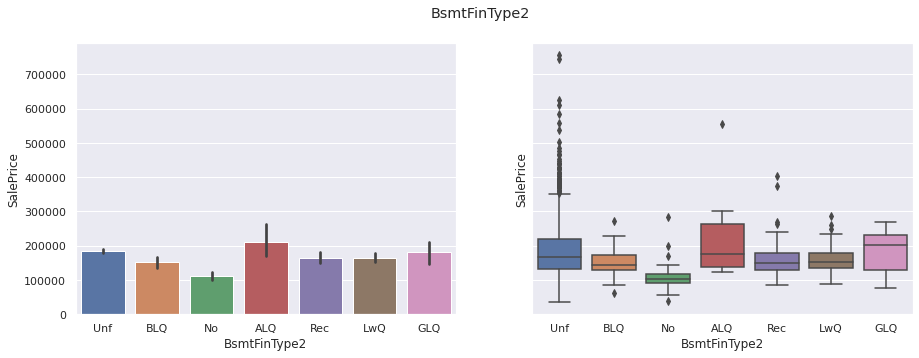

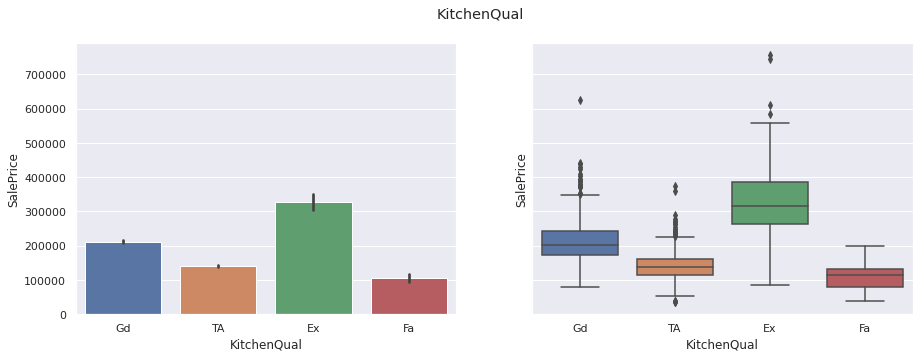

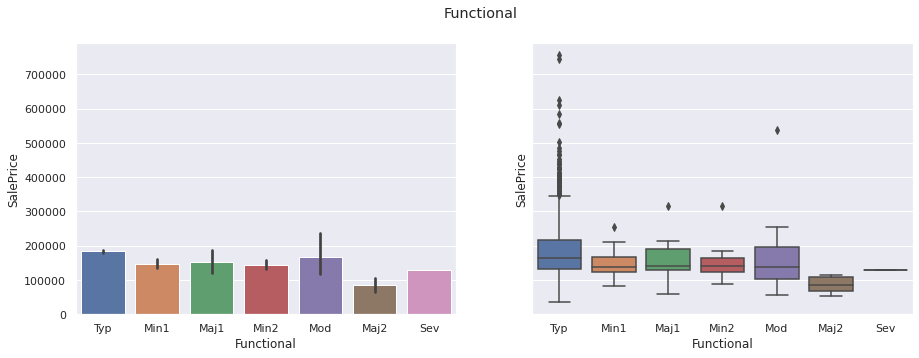

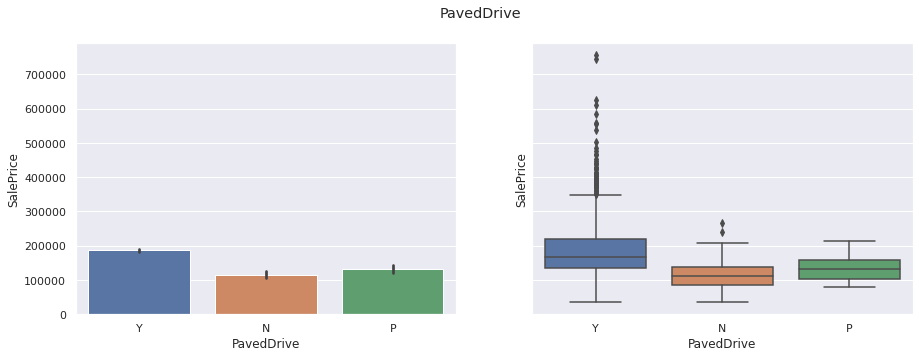

In [15]:
for feature in ordinal:
    fig, ax =plt.subplots(1,2,figsize=(15, 5), sharey=True)
    sns.barplot(data = df, x=feature, y='SalePrice',ax=ax[0])
    sns.boxplot(data=df, x=feature, y="SalePrice", ax=ax[1])
    fig.suptitle(feature)
    fig.show()

### 3.5.3 Numerical Features

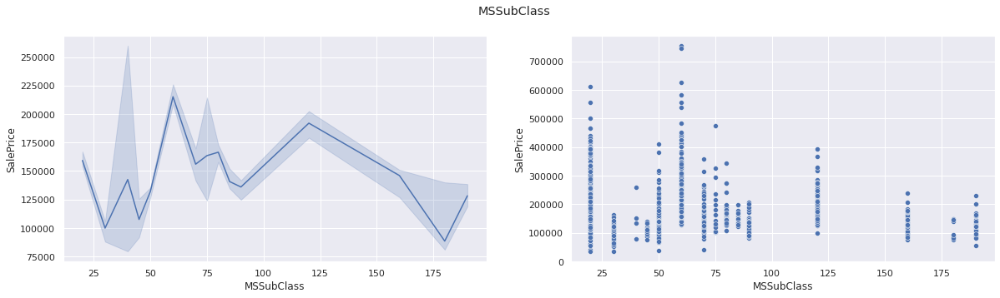

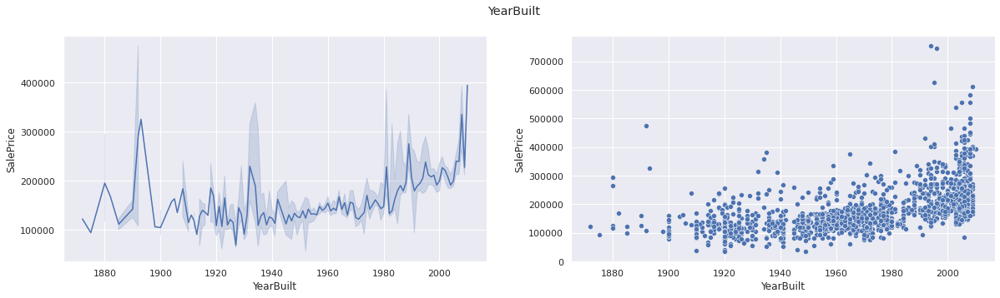

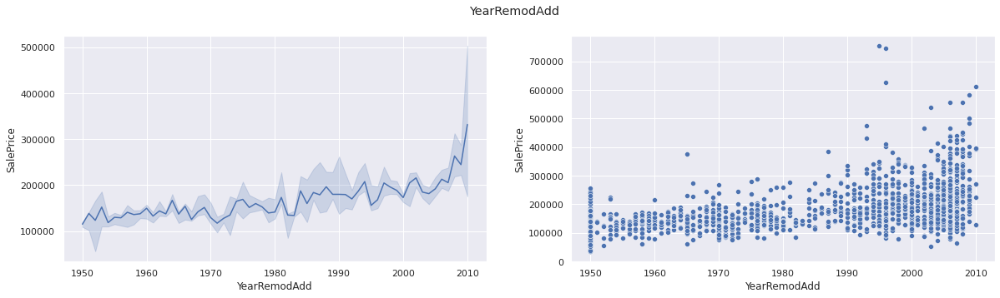

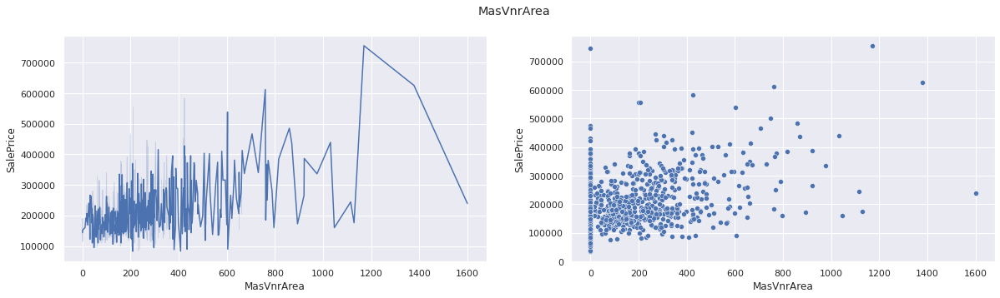

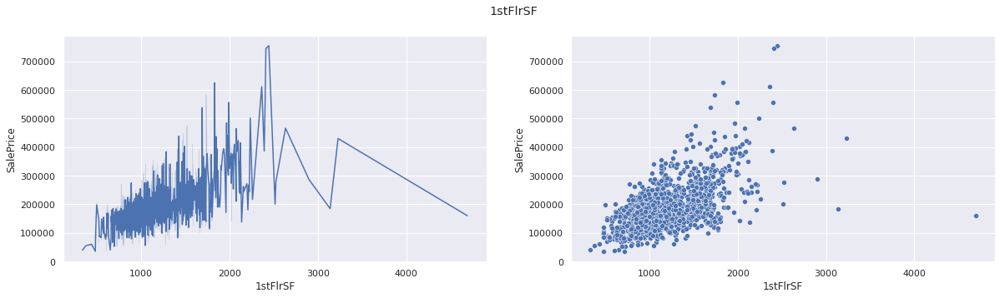

...

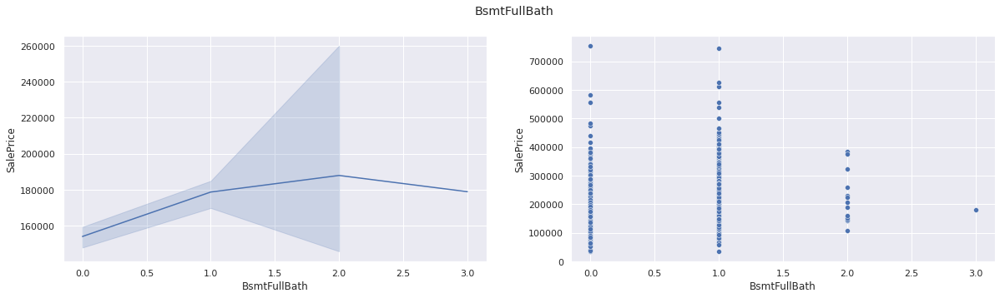

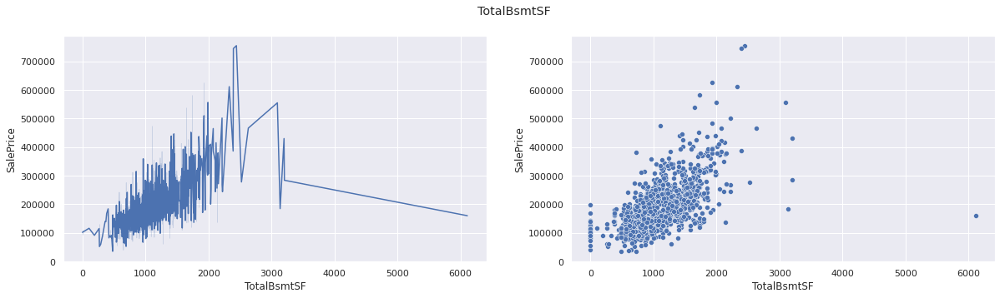

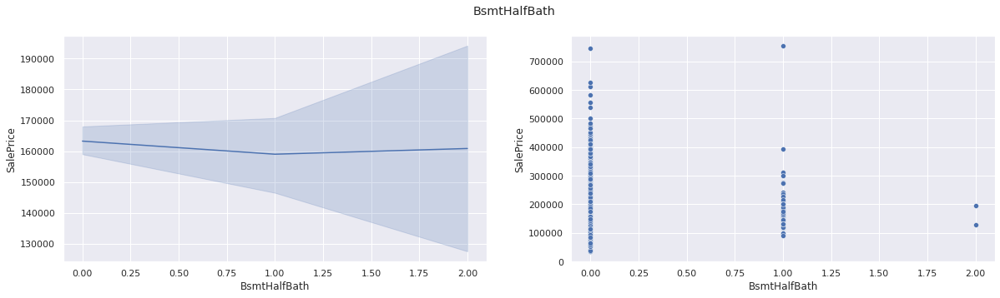

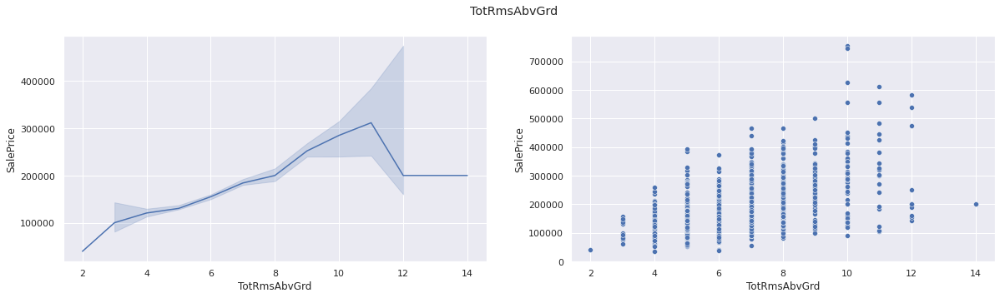

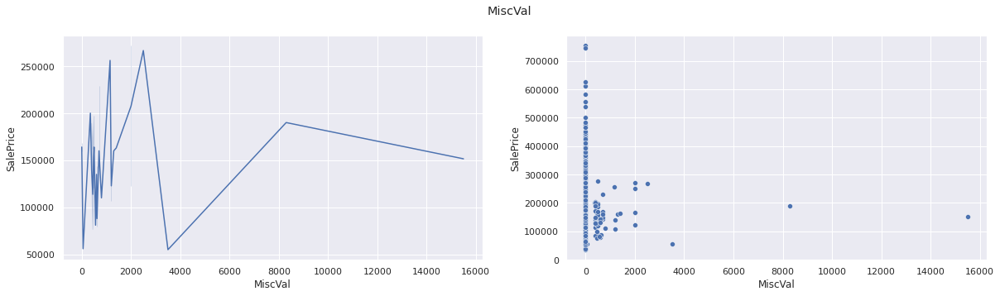

In [16]:
for feature in continous:
    fig, ax =plt.subplots(1,2,figsize=(20, 5))
    fig.suptitle(feature)
    sns.lineplot(x=feature, y="SalePrice",data=df, estimator=np.median, ax=ax[0])
    sns.scatterplot(x=feature, y="SalePrice",data=df,  ax=ax[1])
    fig.show()

## 3.6 Distribution Plots

### 3.6.1 Sale Price

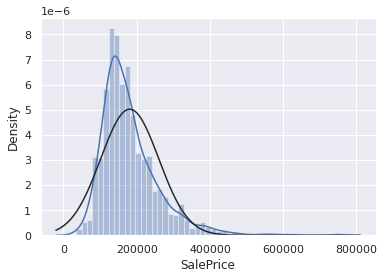

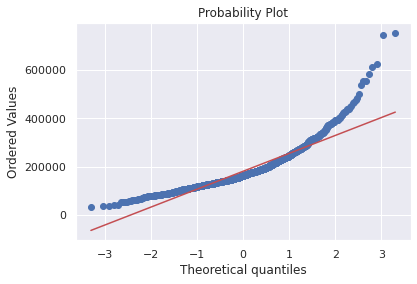

In [17]:
#histogram and normal probability plot
sns.distplot(df['SalePrice'], fit=norm,);
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)

'SalePrice' is not normal. It shows 'peakedness', positive skewness and does not follow the diagonal line.
We can log transform this feature to get normal distribution.

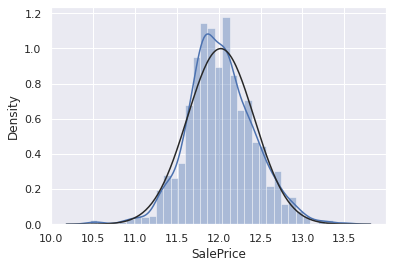

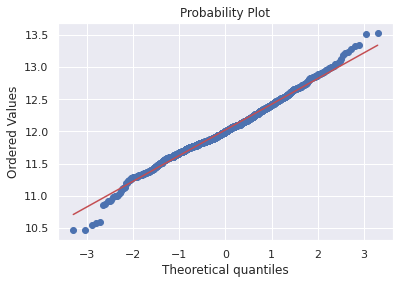

In [18]:
# Applying log transformation
df['SalePrice'] = np.log(df['SalePrice'])

# Transformed histogram and normal probability plot
sns.distplot(df['SalePrice'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)

Similarly we will use same techniqe to normalize the skiwness of the other features.

### 3.6.2 Above Ground Living Area

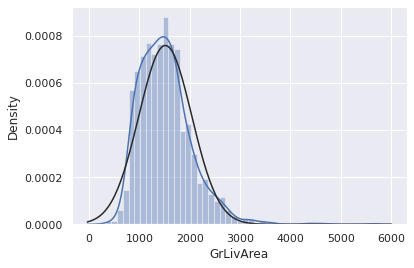

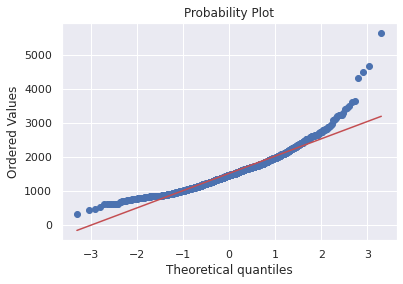

In [19]:
# Above grade (ground) living area square feet
sns.distplot(df['GrLivArea'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['GrLivArea'], plot=plt)

There is a positive skwness in the feature. We need to normalize the feature.

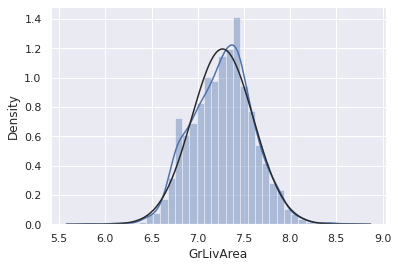

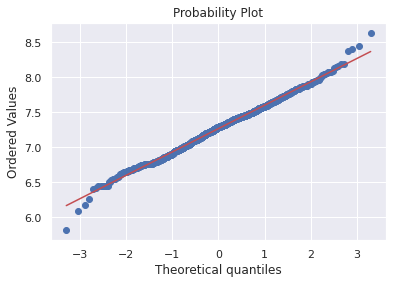

In [20]:
# Normalizing Above grade (ground) living area square feet
df['GrLivArea'] = np.log(df['GrLivArea'])
sns.distplot(df['GrLivArea'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['GrLivArea'], plot=plt)

### 3.6.3 Total basement area

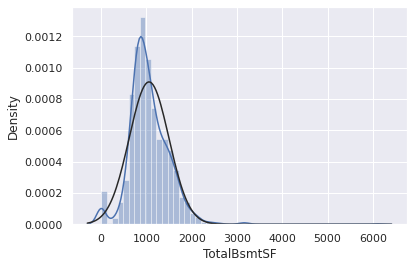

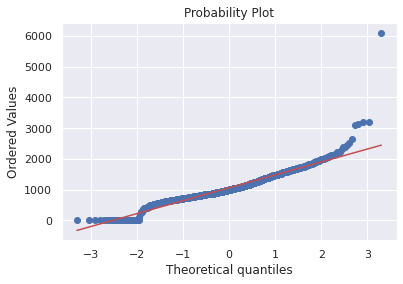

In [21]:
sns.distplot(df['TotalBsmtSF'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['TotalBsmtSF'], plot=plt)

In TotalBsmtSF alot of datapoints have zero values, we have to log transform without affecting them.

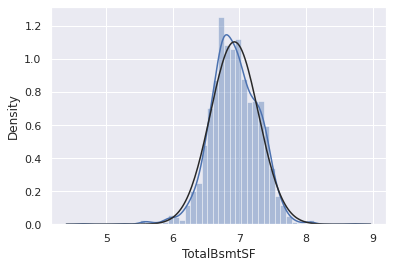

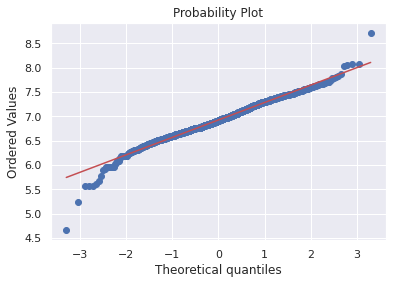

In [22]:
df['TotalBsmtSF'] = df['TotalBsmtSF'].apply(lambda x: np.log(x) if x != 0 else x)

sns.distplot(df[df['TotalBsmtSF']>0]['TotalBsmtSF'], fit=norm);
fig = plt.figure()
res = stats.probplot(df[df['TotalBsmtSF']>0]['TotalBsmtSF'], plot=plt)

### 3.6.5 First Floor Area

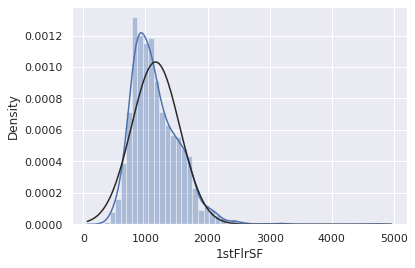

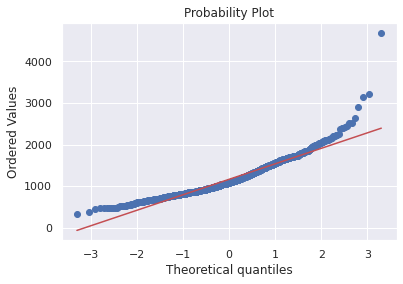

In [23]:
sns.distplot(df['1stFlrSF'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['1stFlrSF'], plot=plt)

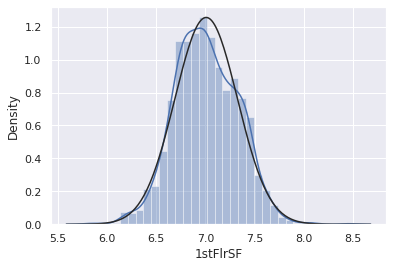

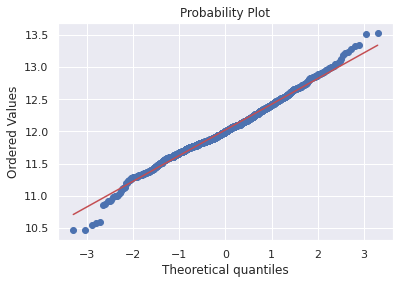

In [24]:
df['1stFlrSF'] = np.log(df['1stFlrSF'])
sns.distplot(df['1stFlrSF'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)

OUTLIARS

In [26]:
# outliars = np.where(df['MasVnrArea'] >= 1200)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['SalePrice'] > 700000)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['MasVnrArea'] >= 1200)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['GrLivArea'] >= 4000)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['EnclosedPorch'] >= 450)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['LotFrontage'] >= 250)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['LotArea'] >= 100000)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['BsmtFinSF1'] >= 3000)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['BsmtFinSF2'] >= 1200)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['TotalBsmtSF'] >= 4000)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# outliars = np.where(df['MiscVal'] >= 6000)
# print(outliars)
# df.drop(outliars[0], inplace = True)

# df.to_csv('final.csv')

(array([ 297, 1169]),)
